# 🐶 Using Transfer Learning and TensorFlow 2.0 to Classify Different Dog Breeds


In [5]:
!pip install tensorflow==2.15.0 tensorflow-hub keras==2.15.0

INFO: pip is looking at multiple versions of tf-keras to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 475.2/475.2 MB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 69.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 52.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 94.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 442.0/442.0 kB 29.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 70.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 7.3 MB/s eta 0:00:00
  Attempting uninstall: wrapt
    Found existing installation: wrapt 1.17.0
    Uninstalling wrapt-1.17.0:
      Successfully uninstalled wrapt-1.17.0
  Attempting uninstall: ml-dtypes
    Found existing installation: ml-dtypes 0.4.1
    Uninstalling ml-dtypes-0.4.1:
      Successfully uninstalled ml-dtypes

#We're going to go through the following TensorFlow/Deep Learning workflow:

1.Get data ready (download from Kaggle, store, import).

2.Prepare the data (preprocessing, the 3 sets, X & y).

3.Choose and fit/train a model (TensorFlow Hub, tf.keras.applications, TensorBoard, EarlyStopping).

4.Evaluating a model (making predictions, comparing them with the ground truth labels).

5.Improve the model through experimentation (start with 1000 images, make sure it works, increase the number of images).

6.Save, sharing and reloading your model (once you're happy with the results).

In [1]:
import tensorflow as tf
import tensorflow_hub as hub

In [2]:
print("tensorflow_version: ",tf.__version__)
print("tensorflow_hub_version: ",hub.__version__)

tensorflow_version:  2.15.0
tensorflow_hub_version:  0.16.1


##Getting data ready

In [8]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


##Accessing the data
Now the data files we're working with are available on our Google Drive, we can start to check it out.

Let's start with labels.csv which contains all of the image ID's and their assosciated dog breed (our data and labels).

In [3]:
import pandas as pd
label_csv= pd.read_csv('/content/drive/MyDrive/dog-breed-identification/labels.csv')
print(label_csv.describe())
print(label_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     fff43b07992508bc822f33d8ffd902ae  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


Looking at this, we can see there are 10222 different ID's (meaning 10222 different images) and 120 different breeds.

Let's figure out how many images there are of each breed.

In [4]:
# How many images are there of each breed?
label_csv["breed"].value_counts()

,count
breed,
scottish_deerhound,126
maltese_dog,117
afghan_hound,116
entlebucher,115
bernese_mountain_dog,114
...,...
golden_retriever,67
komondor,67
brabancon_griffon,67


<Axes: xlabel='breed'>

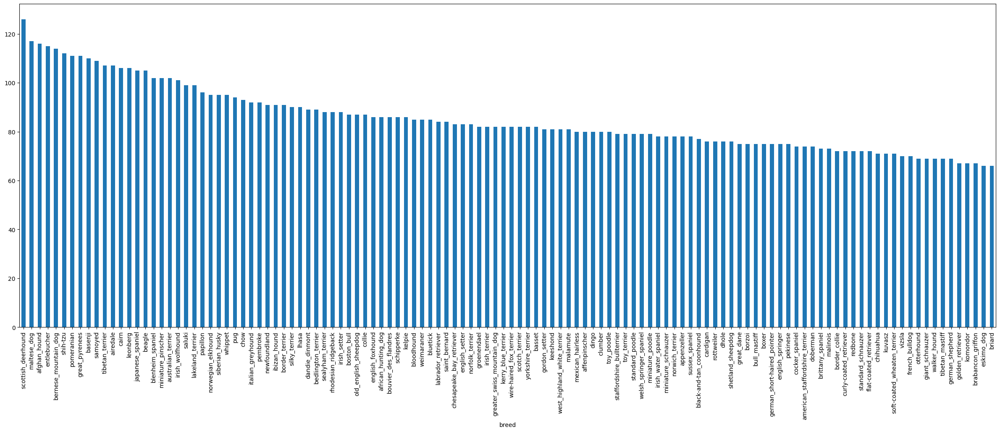

In [5]:
label_csv["breed"].value_counts().plot.bar(figsize=(30, 10))

In [6]:
from IPython.display import Image

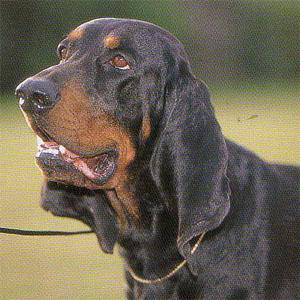

In [7]:
Image("/content/drive/MyDrive/dog-breed-identification/test/"+ "0a0b97441050bba8e733506de4655ea1" + ".jpg")

##Getting Images and their lables

In [8]:
# Create pathnames from image ID's
filenames = ["/content/drive/MyDrive/dog-breed-identification/train/" + fname + ".jpg" for fname in label_csv["id"]]

# Check the first 10 filenames
filenames[:10]
print(len(filenames))

10222


Now we've got a list of all the filenames from the ID column of labels_csv, we can compare it to the number of files in our training data directory to see if they line up.

In [9]:
#Files was required to be renamed and now it is working correctly
import os
# Path to the directory
directory = "/content/drive/MyDrive/dog-breed-identification/train"

# Rename files to remove '(1)'
for filename in os.listdir(directory):
    if " (1)" in filename:
        new_filename = filename.replace(" (1)", "")
        os.rename(os.path.join(directory, filename), os.path.join(directory, new_filename))
        print(f"Renamed: {filename} -> {new_filename}")


In [10]:
# Check whether number of filenames matches number of actual image files
import os
if len(os.listdir("/content/drive/MyDrive/dog-breed-identification/train")) == len(filenames):
  print("Filenames match actual amount of files!")
else:
  print("Filenames do not match actual amount of files, check the target directory.")
print(len(os.listdir("/content/drive/MyDrive/dog-breed-identification/train")))

Filenames match actual amount of files!
10222


In [11]:
filenames_from_csv = [fname + ".jpg" for fname in label_csv["id"]]
filenames_in_directory = os.listdir("/content/drive/MyDrive/dog-breed-identification/train")

# Find mismatched files
missing_files = set(filenames_in_directory) - set(filenames_from_csv)
print("Extra files in directory:", missing_files)


Extra files in directory: set()


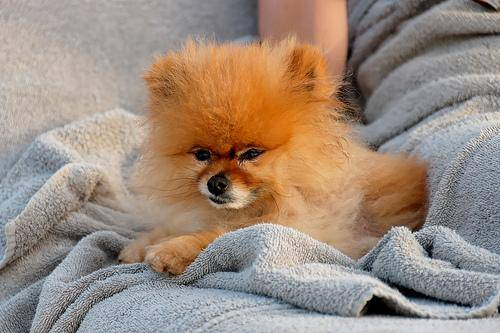

In [12]:
Image(filenames[8000])

In [13]:
import numpy as np
labels = label_csv["breed"].to_numpy() # convert labels column to NumPy array
labels[:10]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever',
       'bedlington_terrier', 'bedlington_terrier', 'borzoi', 'basenji',
       'scottish_deerhound'], dtype=object)

Wonderful, now lets do the same thing as before, compare the amount of labels to number of filenames.

In [14]:
# See if number of labels matches the number of filenames
if len(labels) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames, check data directories.")

Number of labels matches number of filenames!


If it all worked, we should have the same amount of images and labels.

Finally, since a machine learning model can't take strings as input (what labels currently is), we'll have to convert our labels to numbers.

To begin with, we'll find all of the unique dog breed names.

Then we'll go through the list of labels and compare them to unique breeds and create a list of booleans indicating which one is the real label (True) and which ones aren't (False).

In [15]:
unique_labels = np.unique(labels)
unique_labels
len(unique_labels)

120

In [16]:
# Example: Turn one label into an array of booleans
print(labels[0])
labels[0] == unique_labels # use comparison operator to create boolean array

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [17]:
# Turn every label into a boolean array
boolean_labels = [label == np.array(unique_labels) for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [18]:
len(boolean_labels)

10222

Why do it like this?

Remember, an important **concept** in machine learning is converting your **data to numbers** before passing it to a machine learning model.

In this case, we've transformed a single dog breed name such as boston_bull into a one-hot array.

Let's see an example.

In [19]:
# Example: Turning a boolean array into integers
print(labels[0]) # original label
print(np.where(unique_labels == labels[0])[0][0]) # index where label occurs
print(boolean_labels[0].argmax()) # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # there will be a 1 where the sample label occurs

boston_bull
19
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


Wonderful! Now we've got our labels in a numeric format and our image filepaths easily accessible (they aren't numeric yet), let's split our data up.

##Creating our own validation set

Since the dataset from **Kaggle** doesn't come with a validation set (a split of the data we can test our model on before making final predicitons on the test set), let's make one.

We could use **Scikit-Learn's** train_test_split function or we could simply make manual splits of the data.

For accessibility later, let's save our filenames variable to X (data) and our labels to y.

In [20]:
# Setup X & y variables
X = filenames
y = boolean_labels

Since we're working with **10,000+** images, it's a good idea to work with a portion of them to make sure things are working before training on them all.

This is because computing with **10,000+** images could take a fairly long time. And our goal when working through machine learning projects is to reduce the time between experiments.

Let's start experimenting with **1000** and increase it as we need.

In [21]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

In [22]:
#Lets Split our data into train and validation sets
from sklearn.model_selection import train_test_split
np.random.seed(42)
# Split them into training and validation using NUM_IMAGES
X_train,X_val,y_train,y_val = train_test_split(X[:NUM_IMAGES],
                                               y[:NUM_IMAGES],
                                               test_size=0.2,
                                               random_state=42)

In [23]:
len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [24]:
# Check out the training data (image file paths and labels)
X_train[:2], y_train[:2]

(['/content/drive/MyDrive/dog-breed-identification/train/00bee065dcec471f26394855c5c2f3de.jpg',
  '/content/drive/MyDrive/dog-breed-identification/train/0d2f9e12a2611d911d91a339074c8154.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False,

##Preprocessing Images(turning Images to Tensors)
Our labels are in **numeric format** but our images are still just file paths.

Since we're using TensorFlow, our data has to be in the form of Tensors.

**A Tensor is a way to represent information in numbers**.

Because of how TensorFlow stores information (in Tensors), it allows machine learning and deep learning models to be run on GPUs (generally faster at numerical computing).

To preprocess our images into Tensors we're going to write a function which does a few things:

Takes an image filename as input.

1.Uses TensorFlow to read the file and save it to a variable, image.

2.Turn our image (a jpeg file) into Tensors.

3.Resize the image to be of shape (224, 224).

4.Return the modified image.

In [25]:
# Convert image to NumPy array
from matplotlib.pyplot import imread
image = imread(filenames[41]) # read in an image
image.shape

(375, 500, 3)

Notice the shape of image. It's (257, 350, 3). This is height, width, colour channel value.

And you can easily convert it to a Tensor using tf.constant().

In [26]:
image[:2].shape

(2, 500, 3)

In [27]:
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 500, 3), dtype=uint8, numpy=
array([[[63, 52, 24],
        [62, 51, 23],
        [60, 48, 22],
        ...,
        [60, 41, 26],
        [62, 43, 28],
        [63, 44, 29]],

       [[64, 53, 25],
        [63, 52, 24],
        [61, 49, 23],
        ...,
        [61, 42, 27],
        [62, 43, 28],
        [64, 45, 30]]], dtype=uint8)>

In [28]:
# Define image size
IMG_SIZE = 224

def process_image(image_path):
  """
  Takes an image file path and turns it into a Tensor.
  """
  # Read in image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-225 values to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired size (224, 244)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
  return image

##Turning Data into Batches
Wonderful. Now we've got a function to convert our images into Tensors, we'll now build one to turn our data into batches (more specifically, a TensorFlow **BatchDataset**).

**What's a batch?**

A batch (also called mini-batch) is a small portion of your data, say 32 (32 is generally the default batch size) images and their labels. In deep learning, instead of finding patterns in an entire dataset at the same time, you often find them one batch at a time.

Let's say you're dealing with 10,000+ images (which we are). Together, these files may take up more memory than your GPU has. Trying to compute on them all would result in an error.

Instead, it's more efficient to create smaller batches of your data and compute on one batch at a time.

TensorFlow is very efficient when your data is in batches of (image, label) Tensors. So we'll build a function to do create those first. We'll take advantage of of process_image function at the same time.

In [29]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image, label

Now we've got to turn our data into tuples of Tensors in the form of: (image,label),let's make a funtion to tur into batches

In [30]:
# Define the batch size, 32 is a good default
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably don't have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data if a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    # If the data is a training dataset, we shuffle it
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                              tf.constant(y))) # labels

    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(x))

    # Create (image, label) tuples (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [31]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [32]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

Look at that! We've got our data in batches, more specifically, they're in Tensor pairs of (images, labels) ready for use on a GPU.

But having our data in batches can be a bit of a hard concept to understand. Let's build a function which helps us visualize what's going on under the hood.

##Visualizing Data Batches

In [33]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_labels[labels[i].argmax()])
    # Turn gird lines off
    plt.axis("off")

To make computation efficient, a batch is a tighly wound collection of Tensors.

So to view data in a batch, we've got to unwind it.

We can do so by calling the [as_numpy_iterator()](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#as_numpy_iterator) method on a data batch.

This will turn our a data batch into something which can be iterated over.

Passing an iterable to next() will return the next item in the iterator.

In our case, next will return a batch of 32 images and label pairs.

Note: Running the cell below and loading images may take a little while.

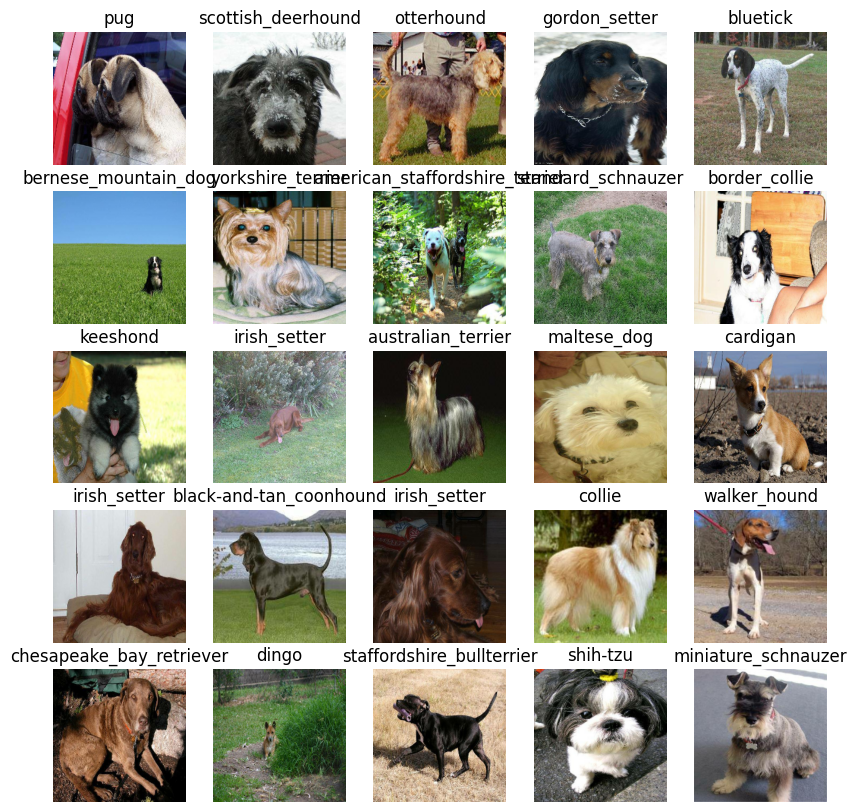

In [34]:
#Visualize training images from the training data batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

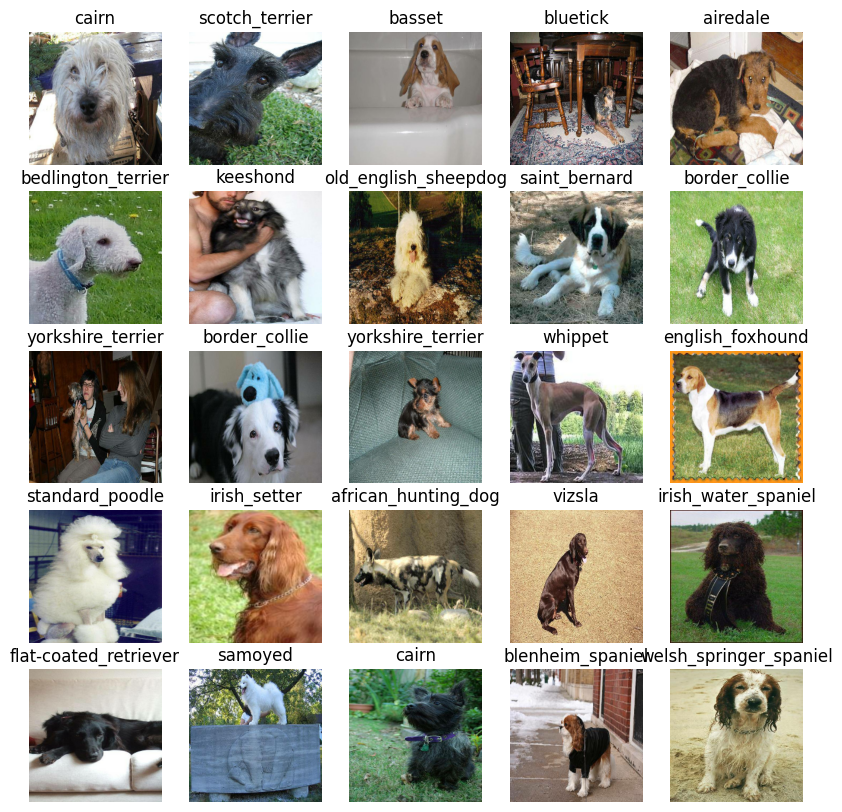

In [35]:
#Visualize training images from the validation data batch
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

Note that re-running the visualizing cell of training data each time gives us a new set because training data need to be shuffled each time. But validation set gives always the same output after re-running the cell ..the validation set need not to be reshuffled.

##Creating and training a model
Now our data is ready, let's prepare it modelling. We'll use an existing model from TensorFlow Hub.

**TensorFlow Hub** is a resource where you can find pretrained machine learning models for the problem you're working on.

Using a pretrained machine learning model is often referred to as **transfer learning**.

**Why use a pretrained model?**
Building a machine learning model and training it on lots from scratch can be expensive and time consuming.

Transfer learning helps eliviate some of these by taking what another model has learned and using that information with your own problem.

**How do we choose a model?**
Since we know our problem is image classification (classifying different dog breeds), we can navigate the TensorFlow Hub page by our problem domain (image).

We start by choosing the image problem domain, and then can filter it down by subdomains, in our case, image classification.

Doing this gives a list of different pretrained models we can apply to our task.

Clicking on one gives us information about the model as well as instructions for using it.

For example, clicking on the mobilenet_v2_130_224 model, tells us this model takes an input of images in the shape 224, 224. It also says the model has been trained in the domain of image classification.

Let's try it out.

##Building a model
Before we build a model, there are a few things we need to define:


*  The input shape (images, in the form of Tensors) to our model.
*  The output shape (image labels, in the form of Tensors) of our model.
*  The URL of the model we want to use.

These things will be standard practice with whatever machine learning model you use. And because we're using TensorFlow, everything will be in the form of Tensors.



The URL of the model we want to use.
These things will be standard practice with whatever machine learning model you use. And because we're using TensorFlow, everything will be in the form of Tensors.

In [36]:
# Setup input shape to the model
INPUT_SHAPE = [IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_labels) # number of unique labels

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"

Now we've got the inputs, outputs and model we're using ready to go. We can start to put them together

There are many ways of building a model in TensorFlow but one of the best ways to get started is to use the Keras API.

Defining a deep learning model in Keras can be as straightforward as saying, "here are the layers of the model, the input shape and the output shape, let's go!"

Knowing this, let's create a function which:
*  Takes the input shape, output shape and the model we've chosen's URL as parameters.
*  Defines the layers in a Keras model in a sequential fashion (do this first, then this, then that).
*   Compiles the model (says how it should be evaluated and improved).
*   Builds the model (tells it what kind of input shape it'll be getting).
*   Returns the model.

In [37]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL,input_shape=input_shape,trainable=False), # Layer 1 (input layer)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this (how wrong its guesses are)
      optimizer=tf.keras.optimizers.Adam(), # A friend telling our model how to improve its guesses
      metrics=["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(INPUT_SHAPE) # Let the model know what kind of inputs it'll be getting

  return model

In [38]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


The **Non-Trainable** parameters are the patterns learned by mobilenet_v2_130_224.

The **trainable** Parameters are the ones in the dense layer we added.

This means the main bulk of the information in our model has already been learned and we're going to take that and adpat it in our own problem.


##Creating Callbacks
Callbacks are helper functions a model can use during training to do such things as: save its progress, checks its progress or stop training early if a model stops improving.

We'll create two callbacks,one for TensorBoard which helps track our model progress an another for early stopping which prevents our model from training for too long.

###TensorBoard CallBack
To setup TensorBoard callback,we need to do 3 things:

1.Load the TensorBoard notebook extension.

2.Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()` function.

3.Visualize our model's training log with the `%tensorboard` magic function(we'll do this after model training).

In [39]:
%load_ext tensorboard

In [40]:
import datetime

#Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  #Create a log directory for storing TensorBoard Logs
  logdir = os.path.join("/content/drive/MyDrive/logs",
                      datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

###Early Stopping Callback

Early stopping helps stop our model from overfitting by stopping training if a certain evaluation metric stops improving.
[Documentation](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping)

In [41]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                               patience=3)

##Training a model ( on subset of data)

Our model is only going to train on 1000 images , to make sure everything is working.

In [42]:
NUM_EPOCHS = 100 #@param {type:"slider",min:10,max:100,step:10}

In [43]:
##Check to make sure we're still running on GPU
print("GPU", "available (YESSSS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU available (YESSSS!!!!)


Let's Create a function which trains a model.
* Create a model using `create_model()`
* Setup a TensorBoard callback using `create_tensorboard_callback()`
* Call the `fit()`fucntion on our model passing it the training data, validation data, number of epochs to train for (`NUM_EPOCHS`)  and the callbacks we'd like to use.
* Return the model.


In [44]:
#Build a function to train and return the trained model
def train_model():

  """
  Trains a given model and returns the trained version.
  """
  #create a model
  model = create_model()

  #create new tensorboard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  #fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard,early_stopping])
  return model





In [45]:
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
25/25 [==============================] - 13s 245ms/step - loss: 4.6673 - accuracy: 0.0900 - val_loss: 3.5584 - val_accuracy: 0.2100
Epoch 2/100
25/25 [==============================] - 6s 235ms/step - loss: 1.7012 - accuracy: 0.6612 - val_loss: 2.2465 - val_accuracy: 0.4400
Epoch 3/100
25/25 [==============================] - 4s 174ms/step - loss: 0.5928 - accuracy: 0.9300 - val_loss: 1.7107 - val_accuracy: 0.5600
Epoch 4/100
25/25 [==============================] - 6s 234ms/step - loss: 0.2617 - accuracy: 0.9862 - val_loss: 1.5248 - val_accuracy: 0.6150
Epoch 5/100
25/25 [==============================] - 5s 211ms/step - loss: 0.1497 - accuracy: 0.9962 - val_loss: 1.4417 - val_accuracy: 0.6300
Epoch 6/100
25/25 [==============================] - 5s 184ms/step - loss: 0.1025 - accuracy: 0.9987 - val_loss: 1.3870 - val_accuracy: 0.6350
Epoch 7/100
25/25 [=============================

**Question:**It seems that our model is performing way better on training datset rather than on validating datset. What are some ways to prevent model overfitting in depp learning neural networks?

**NOTE:**
Overfitting to begin with is a good thing! It means our model is learning.

In [46]:
%tensorboard --logdir /content/drive/MyDrive/logs

Output hidden; open in https://colab.research.google.com to view.

##Making and evaluating predictions using a Trained model

In [47]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [49]:
#Make predictions on the validation data (not used to train on)
predictions = model.predict(val_data ,verbose=1)

7/7 [==============================] - 1s 117ms/step


In [50]:
predictions

array([[8.0232811e-04, 7.1152521e-05, 1.7189985e-03, ..., 1.7851204e-04,
        1.4307852e-05, 1.1797980e-03],
       [6.3434505e-04, 1.5295422e-04, 1.5011001e-03, ..., 1.3101620e-04,
        3.1968206e-04, 1.5250618e-04],
       [1.0966195e-05, 2.9792018e-05, 7.2255862e-05, ..., 1.9699370e-04,
        2.4080015e-05, 1.5444423e-04],
       ...,
       [2.6534267e-06, 1.8193576e-05, 1.9380061e-05, ..., 6.9796833e-06,
        6.5620079e-05, 1.2506302e-05],
       [2.6121158e-03, 1.6730308e-04, 1.9242035e-04, ..., 1.5935725e-04,
        2.8043345e-05, 1.1879777e-02],
       [5.8119313e-04, 9.0897447e-05, 1.2223829e-03, ..., 6.6462732e-03,
        6.7988964e-04, 7.5870380e-06]], dtype=float32)

In [51]:
predictions[0]

array([8.02328112e-04, 7.11525208e-05, 1.71899854e-03, 3.58197976e-05,
       2.27711294e-04, 7.72989224e-05, 2.75160391e-02, 1.40904577e-03,
       3.95211333e-04, 1.91745741e-04, 1.10777924e-04, 1.40272692e-04,
       1.53397908e-04, 9.54933603e-06, 4.80895978e-05, 5.89310133e-04,
       4.33744572e-05, 3.28937411e-01, 1.45040094e-05, 5.01442119e-04,
       7.55640562e-04, 4.15089977e-04, 6.48022524e-06, 9.57306242e-04,
       2.02820156e-04, 3.19916697e-04, 2.68216759e-01, 5.11832041e-05,
       3.31513613e-04, 6.42353902e-04, 3.75705917e-04, 9.59041470e-04,
       4.40187025e-04, 4.58604190e-05, 1.37512261e-05, 2.07199454e-02,
       5.86308943e-06, 2.68435280e-04, 8.28445045e-05, 6.04090601e-05,
       5.72750694e-04, 5.92780525e-05, 3.86203719e-05, 1.56193622e-04,
       6.29975548e-05, 1.27842868e-04, 3.22801643e-05, 2.45785294e-03,
       5.50615368e-04, 4.43518038e-05, 2.89963762e-04, 2.99898165e-05,
       1.88493432e-04, 4.63918550e-05, 2.89211875e-05, 3.36933881e-05,
      

In [52]:
predictions.shape

(200, 120)

Making predictions with our model returns an array with a different value for each label.

In this case, making predictions on the validation data (200 images) returns an array (predictions) of arrays, each containing 120 different values (one for each unique dog breed).

These different values are the probabilities or the likelihood the model has predicted a certain image being a certain breed of dog. The higher the value, the more likely the model thinks a given image is a specific breed of dog.

Let's see how we'd convert an array of probabilities into an actual label.

In [53]:
# First prediction
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_labels[np.argmax(predictions[0])]}") # the predicted label

[8.02328112e-04 7.11525208e-05 1.71899854e-03 3.58197976e-05
 2.27711294e-04 7.72989224e-05 2.75160391e-02 1.40904577e-03
 3.95211333e-04 1.91745741e-04 1.10777924e-04 1.40272692e-04
 1.53397908e-04 9.54933603e-06 4.80895978e-05 5.89310133e-04
 4.33744572e-05 3.28937411e-01 1.45040094e-05 5.01442119e-04
 7.55640562e-04 4.15089977e-04 6.48022524e-06 9.57306242e-04
 2.02820156e-04 3.19916697e-04 2.68216759e-01 5.11832041e-05
 3.31513613e-04 6.42353902e-04 3.75705917e-04 9.59041470e-04
 4.40187025e-04 4.58604190e-05 1.37512261e-05 2.07199454e-02
 5.86308943e-06 2.68435280e-04 8.28445045e-05 6.04090601e-05
 5.72750694e-04 5.92780525e-05 3.86203719e-05 1.56193622e-04
 6.29975548e-05 1.27842868e-04 3.22801643e-05 2.45785294e-03
 5.50615368e-04 4.43518038e-05 2.89963762e-04 2.99898165e-05
 1.88493432e-04 4.63918550e-05 2.89211875e-05 3.36933881e-05
 5.22736445e-05 1.14519545e-03 1.82586908e-03 5.56787327e-02
 3.86230065e-04 2.92575496e-05 4.20119322e-04 3.54299773e-05
 3.27276037e-04 4.340893

Having this information is great but it would be even better if we could compare a prediction to its true label and original image.

To help us, let's first build a little function to convert prediction probabilities into predicted labels.

**Note:** Prediction probabilities are also known as confidence levels.

In [55]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_labels[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[0])
pred_label

'border_terrier'

Wonderful! Now we've got a list of all different predictions our model has made, we'll do the same for the validation images and validation labels.

Remember, the model hasn't trained on the validation data, during the `fit()` function, it only used the validation data to evaluate itself. So we can use the validation images to visually compare our models predictions with the validation labels.

Since our validation data (`val_data`) is in batch form, to get a list of validation images and labels, we'll have to unbatch it (using unbatch()) and then turn it into an iterator using `as_numpy_iterator()`.

Let's make a small function to do so.

In [57]:
# Create a function to unbatch a batched dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_labels[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

Nailed it!

Now we've got ways to get:

* Prediction labels
* Validation labels (truth labels)
* Validation images

Let's make some functions to make these all a bit more visualize.

More specifically, we want to be able to view an image, its predicted label and its actual label (true label).

The first function we'll create will:

* Take an array of prediction probabilities, an array of truth labels, an array of images and an integer.
* Convert the prediction probabilities to a predicted label.
* Plot the predicted label, its predicted probability, the truth label and target image on a single plot.


In [58]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

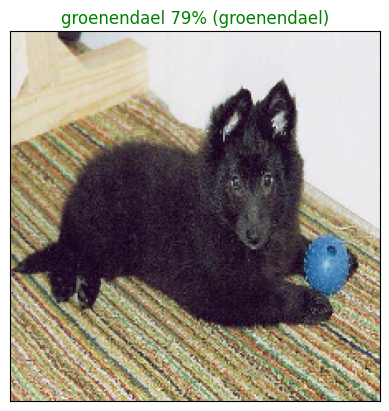

In [61]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=77)

Nice! Making functions to help visual your models results are really helpful in understanding how your model is doing.

Since we're working with a multi-class problem (120 different dog breeds), it would also be good to see what other guesses our model is making. More specifically, if our model predicts a certain label with 24% probability, what else did it predict?

Let's build a function to demonstrate. The function will:

* Take an input of a prediction probabilities array, a ground truth labels array and an integer.
* Find the predicted label using get_pred_label().
* Find the top 10:
  * Prediction probabilities indexes
  * Prediction probabilities values
  * Prediction labels
* Plot the top 10 prediction probability values and labels, coloring the true label green.

In [63]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_labels[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

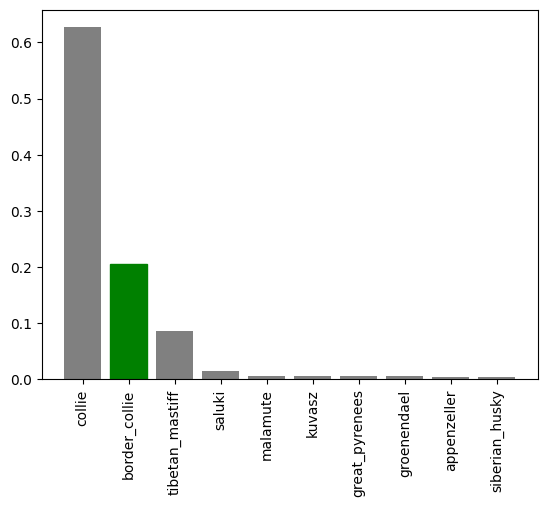

In [64]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

Wonderful! Now we've got some functions to help us visualize our predictions and evaluate our model, let's check out a few.

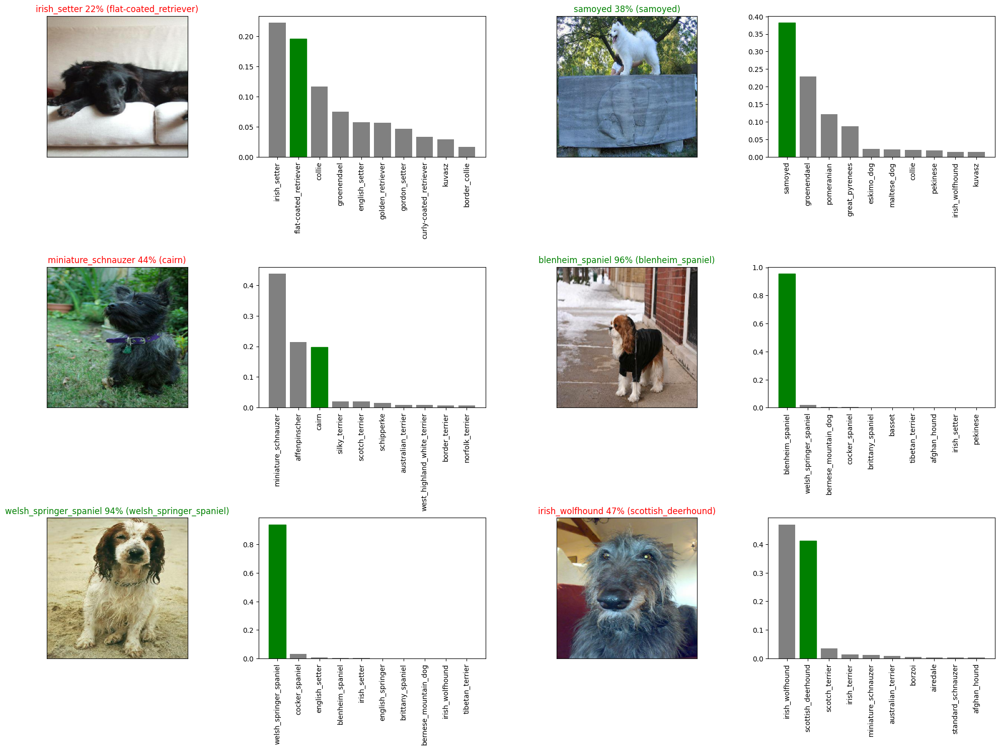

In [67]:
# Let's check a few predictions and their different values
i_multiplier = 20
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

##Saving and Reloading the model

After training a model, it's a good idea to save it. Saving it means you can share it with colleagues, put it in an application and more importantly, won't have to go through the potentially expensive step of retraining it.

The format of an entire saved Keras model is h5. So we'll make a function which can take a model as input and utilise the `save()` method to save it as a `h5` file to a specified directory.

In [68]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("/content/drive/MyDrive/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

If we've got a saved model, we'd like to load it, let's create a function which can take a model path and use the `tf.keras.models.load_model()` function to load it into the notebook.

Because we're using a component from TensorFlow Hub (`hub.KerasLayer`) we'll have to pass this as a parameter to the custom_objects parameter.

In [3]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [70]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-Adam")

Saving model to: /content/drive/MyDrive/models/20241223-15131734966797-1000-images-Adam.h5...


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'/content/drive/MyDrive/models/20241223-15131734966797-1000-images-Adam.h5'

In [72]:
# Load our model trained on 1000 images
model_1000_images = load_model('/content/drive/MyDrive/models/20241223-15131734966797-1000-images-Adam.h5')

Loading saved model from: /content/drive/MyDrive/models/20241223-15131734966797-1000-images-Adam.h5


In [73]:
# Evaluate the loaded model
model_1000_images.evaluate(val_data)

7/7 [==============================] - 3s 179ms/step - loss: 1.2515 - accuracy: 0.6650


[1.2515151500701904, 0.6650000214576721]

##Training the model (on full dataset)

Now we know our model works on a subset of the data, we can start to move forward with training one on the full data.

Above, we saved all of the training filepaths to X and all of the training labels to y. Let's check them out.


In [74]:
# Remind ourselves of the size of the full dataset
len(X), len(y)

(10222, 10222)

here we go! We've got over 10,000 images and labels in our training set.

Before we can train a model on these, we'll have to turn them into a data batch.

The beautiful thing is, we can use our `create_data_batches()` function from above which also preprocesses our images for us (thank you past us for writing a helpful function).

In [75]:
# Turn full training data in a data batch
full_data = create_data_batches(X, y)

Creating training data batches...


Our data is in a data batch, all we need now is a model.

And surprise, we've got a function for that too! Let's use **`create_model()`** to instantiate another model.

In [76]:
# Instantiate a new model for training on the full dataset
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


Since we've made a new model instance, **full_model**, we'll need some callbacks too.

In [77]:
# Create full model callbacks

# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

To monitor the model whilst it trains, we'll load TensorBoard (it should update every 30-seconds or so whilst the model trains).

In [78]:
%tensorboard --logdir /content/drive/MyDrive/logs

Output hidden; open in https://colab.research.google.com to view.

**Note:** Since running the cell below will cause the model to train on all of the data (10,000+) images, it may take a fairly long time to get started and finish. However, thanks to our **`full_model_early_stopping`** callback, it'll stop before it starts going too long.

Remember, the first epoch is always the longest as data gets loaded into memory. After it's there, it'll speed up.

In [79]:
# Fit the full model to the full training data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard,
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 60s 169ms/step - loss: 1.3328 - accuracy: 0.6754
Epoch 2/100
320/320 [==============================] - 51s 159ms/step - loss: 0.3989 - accuracy: 0.8804
Epoch 3/100
320/320 [==============================] - 54s 170ms/step - loss: 0.2372 - accuracy: 0.9362
Epoch 4/100
320/320 [==============================] - 53s 165ms/step - loss: 0.1534 - accuracy: 0.9630
Epoch 5/100
320/320 [==============================] - 49s 153ms/step - loss: 0.1067 - accuracy: 0.9784
Epoch 6/100
320/320 [==============================] - 49s 153ms/step - loss: 0.0768 - accuracy: 0.9857
Epoch 7/100
320/320 [==============================] - 49s 152ms/step - loss: 0.0591 - accuracy: 0.9913
Epoch 8/100
320/320 [==============================] - 47s 148ms/step - loss: 0.0462 - accuracy: 0.9945
Epoch 9/100
320/320 [==============================] - 46s 142ms/step - loss: 0.0372 - accuracy: 0.9958
Epoch 10/100
320/320 [==============================] - 45s 141m

In [80]:
# Save model to file
save_model(full_model, suffix="all-images-Adam")

Saving model to: /content/drive/MyDrive/models/20241223-15581734969527-all-images-Adam.h5...


'/content/drive/MyDrive/models/20241223-15581734969527-all-images-Adam.h5'

In [4]:
import pandas as pd
# Load in the full model
loaded_full_model = load_model('/content/drive/MyDrive/models/20241223-15581734969527-all-images-Adam.h5')

Loading saved model from: /content/drive/MyDrive/models/20241223-15581734969527-all-images-Adam.h5


NameError: name 'tf' is not defined